# #NEWS on Twitter
## By: Zan Sadiq, Gordon Amoako
---
Background:

The data used in this project was sourced using the `snscrape` package to scrape Twitter. The subject of the search was #news. The search parameters extended from January 2021 until August 2022. The search yielded 15gb of data which equate to a little over 6 million tweets. In this notebook, we analyze the resulting networks that arise from within this content.

---


In [6]:
# Import libraries
import pandas as pd
import re
import string
from collections import Counter
import networkx as nx
import nltk
from nltk.corpus import words
import gensim
import gensim.corpora as corpora
from gensim.models import CoherenceModel
from gensim.models.ldamulticore import LdaMulticore
import matplotlib.pyplot as plt
import openai
import json
import ast
from igraph import *
from textblob import TextBlob
import numpy as np
import os
os.chdir('/home/dataguy/Documents/')
os.environ['PYSPARK_SUBMIT_ARGS'] = '--jars graphframes-0.8.2-spark3.0-s_2.12.jar pyspark-shell'
from neo4j import GraphDatabase, basic_auth
from graph_tool.all import *
import graphistry
from IPython.core.display import display
from IPython.display import IFrame
import pyspark 
from pyspark import SparkContext, SparkConf
from pyspark.sql import SQLContext, SparkSession
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType, ArrayType, FloatType
from pyspark.sql.functions import udf, col, size, lit, explode, isnan, when, count, min, max, struct, array, monotonically_increasing_id
from pyspark.ml.feature import HashingTF, IDF, Tokenizer, IndexToString, StringIndexer, VectorIndexer, CountVectorizer
import nxviz as nv
%matplotlib inline
import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import datashade, bundle_graph
import datashader as ds
import datashader.transfer_functions as tf
from datashader.layout import random_layout, circular_layout, forceatlas2_layout
from datashader.bundling import connect_edges, hammer_bundle

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
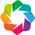

In [7]:
hv.extension('bokeh')
defaults = dict(width = 400, height = 400)

kwargs = dict(width = 800, height = 800, xaxis = None, yaxis = None)
opts.defaults(opts.Nodes(**kwargs), opts.Graph(**kwargs))

colors = ['#000000'] + hv.Cycle('Category20').values

hv.opts.defaults(opts.EdgePaths(**defaults), opts.Graph(**defaults), opts.Nodes(**defaults))

In [8]:
os.chdir('/home/dataguy/Downloads')

In [9]:
!ls

firefox.tmp				graphframes-0.8.2-spark3.0-s_2.12.jar
gephi-0.9.7				headshot.png
gephi-0.9.7-linux-x64.tar.gz		jdk-11.0.16+8
google-chrome-stable_current_amd64.deb	neo4j-desktop-1.4.15-x86_64.AppImage
graphframes-0.8.2-spark2.4-s_2.11.jar	Profile.pdf


In [10]:
#!pyspark --packages graphframes:graphframes:0.8.2-spark3.0-s_2.12 --jars graphframes-0.8.2-spark3.0-s_2.12.jar
#os.environ['PYSPARK_SUBMIT_ARGS'] = '--packages graphframes:graphframes:0.8.1-spark3.0-s_2.12 pyspark-shell'
#from graphframes import *

#import snap
# SNAP
# create a graph TNGraph
#g1 = snap.TNGraph.New()

#for tweeter in nodes:
    
#    g1.AddNode(tweeter)

# Initialize spark
#conf = pyspark.SparkConf().set('spark.driver.host','127.0.0.1').setMaster("local[*]")
#sc = SparkContext.getOrCreate(SparkConf().setMaster("local[*]"))
#spark = SparkSession.builder.config("spark.jars.packages", "graphframes:graphframes:0.8.1-spark3.0-s_2.12").config("spark.jars.repositories", "https://repos.spark-packages.org").getOrCreate()

# Init
#conf = SparkConf().set('spark.driver.host', '192.168.1.159').set('spark.jars', '/home/dataguy/.ivy2/jars').setMaster('local[*]')
#sc = SparkContext.getOrCreate(conf)
#sc.addPyFile('graphframes-0.8.2-spark3.0-s_2.12.jar')
#spark = SparkSession.builder.getOrCreate()

In [11]:
# Initialize spark
sc = SparkContext.getOrCreate(SparkConf().setMaster("local[*]"))
spark = SparkSession.builder.getOrCreate()

22/08/28 08:22:01 WARN Utils: Your hostname, computer resolves to a loopback address: 127.0.1.1; using 192.168.1.159 instead (on interface wlp0s20f3)
22/08/28 08:22:01 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address
22/08/28 08:22:01 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
Using Spark's default log4j profile: org/apache/spark/log4j-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


In [17]:
# Read
df = spark.read.json('/home/dataguy/hashtag-news.json')

22/08/28 08:22:59 WARN package: Truncated the string representation of a plan since it was too large. This behavior can be adjusted by setting 'spark.sql.debug.maxToStringFields'.


In [18]:
# Inspect
min_date, max_date = df.select(min("date"), max("date")).first()
print(f'Total # Tweets: {df.count()}')
print(f"Min Date- {min_date}")
print(f"Max Date- {max_date}")

Total # Tweets: 6080314
Min Date- 2021-01-11T06:14:01+00:00
Max Date- 2022-08-23T14:19:11+00:00


In [19]:
# Expand
df1 = df.withColumn('username', col('user.username')).withColumn('country', col('place.country')).withColumn('country_cd', col('place.countryCode'))
df2 = df1.withColumn('quoted', col('quotedTweet.user.username')).withColumn('mentions', col('mentionedUsers.username')).withColumn('reply_to', col('inReplyToUser.username')).drop('inReplyToUser', 'mentionedUsers', 'renderedContent', 'id', 'media', 'outlinks', '_type', 'cashtags', 'conversationId', 'inReplyToTweetId', 'source', 'sourceUrl', 'sourceLabel', 'tcooutlinks', 'url', 'country', 'lang', 'retweetedTweet', 'user', 'coordinates', 'place', 'quotedTweet').sample(.2)

# Extract nodes
users = [x[0] for x in df2.select('username').distinct().collect()]
quoted = [x[0] for x in df2.select('quoted').distinct().collect()]
mentions = df2.select('mentions').distinct().collect()
replies = [x[0] for x in df2.select('reply_to').distinct().collect()]

# Flatten
mnts = []

# Iterate mentions
for x in mentions:
    
    for y in x:
        
            if y:
                
                for z in y:
                
                    mnts.append(z)
                    
nodes = users + quoted + mnts + replies
nodes = [i for i in set(nodes)]

In [20]:
# Function to for edges
def get_quotes(x, y):

    if y is not None:
        
        edges.append((x, y, 'quote'))
    
    else:
        
        pass
    
def get_mentions(x, y):
    
    if y is not None:
        
        for z in y:
            
            edges.append((x, z, 'mention'))
            
    else:
        
        pass
    
def get_replies(x, y):
    
    if y is not None:
        
        edges.append((x, y, 'reply'))

In [21]:
# Apply functions to build edges
edges = []

# Quotes
for x, y in df2.select('username', 'quoted').collect(): get_quotes(x, y)
for x, y in df2.select('username', 'mentions').collect(): get_mentions(x, y)
for x, y in df2.select('username', 'reply_to').collect(): get_replies(x, y)

edgedf = pd.DataFrame(edges, columns = ['source', 'target', 'type'])
edgedf = edgedf.groupby(['source', 'target', 'type']).size().reset_index().rename({0: 'weight'}, axis = 1)
edgedf = edgedf[edgedf['source'] != edgedf['target']]

In [22]:
nodedf = pd.DataFrame(nodes, columns = ['username'])
nde = pd.DataFrame(nodes, columns = ['username'])
nde['id'] = [i for i in range(0, len(nde))]

In [23]:
nde.head()

,username,id
0,djangoritu,0
1,HobeckBooks,1
2,eNewsChannels,2
3,dvorak0001,3
4,LIVEpositivity,4


In [24]:
edg = edgedf.merge(nde, how = 'left', left_on = 'source', right_on = 'username').rename({'id': 'src'}, axis = 1).drop('username', axis = 1)
edg = edg.merge(nde, how = 'left', left_on = 'target', right_on = 'username').rename({'id': 'dst'}, axis = 1).drop('username', axis = 1)

In [25]:
edg.head()

,source,target,type,weight,src,dst
0,004nino,denverpost,mention,1,81220,2060
1,007HeadedDragon,globeandmail,quote,1,13673,14946
2,007radiotv,spreaker,mention,1,23683,22979
3,01rebellious,SpaceX,mention,1,56339,40226
4,03_meet,ABPNews,mention,2,40481,95337


In [26]:
'''
    GraphFrames
'''

# Build dataframes
sparknodes = spark.createDataFrame(nde, ['username', 'id'])
sparkedges = spark.createDataFrame(edg, ['source', 'target', 'type', 'weight', 'src', 'dst'])

In [27]:
sparknodes.show(5)

+--------------+---+
|      username| id|
+--------------+---+
|    djangoritu|  0|
|   HobeckBooks|  1|
| eNewsChannels|  2|
|    dvorak0001|  3|
|LIVEpositivity|  4|
+--------------+---+
only showing top 5 rows



In [28]:
sparkedges.show(5)

+---------------+------------+-------+------+-----+-----+
|         source|      target|   type|weight|  src|  dst|
+---------------+------------+-------+------+-----+-----+
|        004nino|  denverpost|mention|     1|81220| 2060|
|007HeadedDragon|globeandmail|  quote|     1|13673|14946|
|     007radiotv|    spreaker|mention|     1|23683|22979|
|   01rebellious|      SpaceX|mention|     1|56339|40226|
|        03_meet|     ABPNews|mention|     2|40481|95337|
+---------------+------------+-------+------+-----+-----+
only showing top 5 rows



In [29]:
#graph = GraphFrame(sparknodes, sparkedges)
# Find most important tweeters
#results = graph.pageRank(resetProbability = 0.01, maxIter = 100)
#results.vertices.select("id", "pagerank").show()

In [30]:
'''
    Network X 
'''

sample = edgedf.sort_values('weight', ascending = False)[0:2500]

In [31]:
# Graph
g = nx.from_pandas_edgelist(sample, 
                            source = 'source',
                            target = 'target',
                            edge_attr = ['type', 'weight'],
                            create_using = nx.DiGraph())

/home/dataguy/miniconda3/lib/python3.9/site-packages/nxviz/api.py:275: UserWarning: As of nxviz 0.7, the object-oriented API is being deprecated in favour of a functional API. Please consider switching your plotting code! The object-oriented API wrappers remains in place to help you transition over. A few changes between the old and new API exist; please consult the nxviz documentation for more information. When the 1.0 release of nxviz happens, the object-oriented API will be dropped entirely.
  warnings.warn(


<Figure size 1440x1080 with 0 Axes>

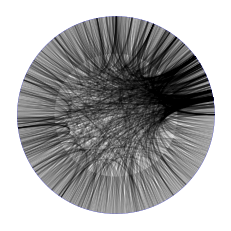

In [32]:
# Create the CircosPlot object: c
plt.figure(figsize = (20, 15))
c = nv.CircosPlot(g)
plt.show()

In [33]:
# Datashader
# Functions for plotting 
cvsopts = dict(plot_height = 400, plot_width = 400)
def nodesplot(nodes, name = None, canvas = None, cat = None):
    
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    aggregator = None if cat is None else ds.count_cat(cat)
    agg = canvas.points(nodes,'x','y',aggregator)
    
    return tf.spread(tf.shade(agg, cmap = ["#FF3333"]), px = 3, name = name)

def edgesplot(edges, name = None, canvas = None):
    
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    return tf.shade(canvas.line(edges, 'x','y', agg = ds.count()), name = name)
    
def graphplot(nodes, edges, name = "", canvas = None, cat = None):
    
    if canvas is None:
        
        xr = nodes.x.min(), nodes.x.max()
        yr = nodes.y.min(), nodes.y.max()
        
        canvas = ds.Canvas(x_range = xr, y_range = yr, **cvsopts)
        
    np = nodesplot(nodes, name + " nodes", canvas, cat)
    ep = edgesplot(edges, name + " edges", canvas)
    
    return tf.stack(ep, np, how = "over", name = name)

In [34]:
nodes = pd.DataFrame(["node" + str(i) for i in range(1000)], columns = ['name'])
edges = pd.DataFrame(np.random.randint(0,len(nodes), size = (20000, 2)), columns = ['source', 'target'])

In [35]:
circularloc  = circular_layout(nodes, uniform = False)
randomloc = random_layout(nodes)
randomloc.tail()

,name,x,y
995,node995,0.803498,0.725202
996,node996,0.011338,0.490268
997,node997,0.870902,0.853387
998,node998,0.515638,0.472522
999,node999,0.051057,0.000170


In [36]:
edges.head()

,source,target
0,728,587
1,56,534
2,887,737
3,779,203
4,405,620


Random layout,Circular layout

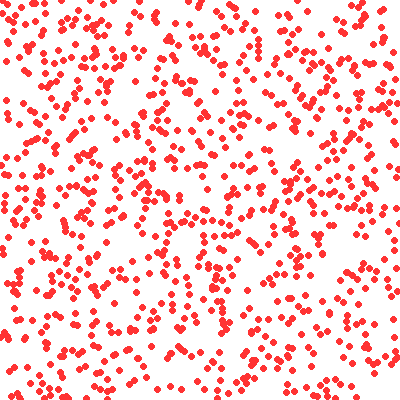
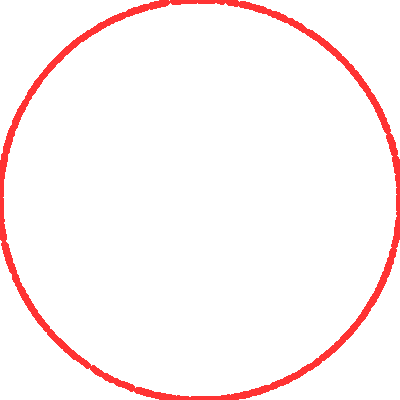

In [37]:
tf.Images(nodesplot(randomloc, "Random layout"), nodesplot(circularloc, "Circular layout"))

CPU times: user 897 ms, sys: 0 ns, total: 897 ms
Wall time: 894 ms


ForceAtlas2 layout

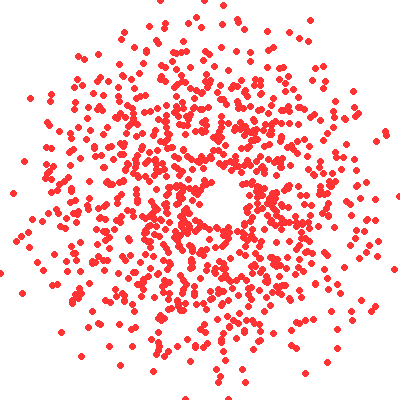

In [39]:
%time forcedirectedloc = forceatlas2_layout(nodes, edges)
tf.Images(nodesplot(forcedirectedloc, "ForceAtlas2 layout"))

In [41]:
cd = circularloc
fd = forcedirectedloc

%time a = graphplot(cd, connect_edges(cd,edges), "Circular layout")
%time b = graphplot(fd, connect_edges(fd,edges), "Force Directed layout")
%time c = graphplot(cd, hammer_bundle(cd, edges), "Circular layout, bundled")
%time d = graphplot(fd, hammer_bundle(fd, edges), "Force-directed, bundled")

CPU times: user 949 ms, sys: 0 ns, total: 949 ms
Wall time: 974 ms
CPU times: user 176 ms, sys: 0 ns, total: 176 ms
Wall time: 175 ms
CPU times: user 23.9 s, sys: 39 ms, total: 23.9 s
Wall time: 23.9 s
CPU times: user 15.6 s, sys: 3.64 ms, total: 15.6 s
Wall time: 15.6 s


Circular layout,Force Directed layout
"Circular layout, bundled","Force-directed, bundled"

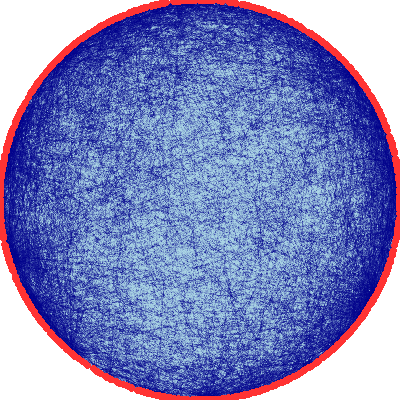
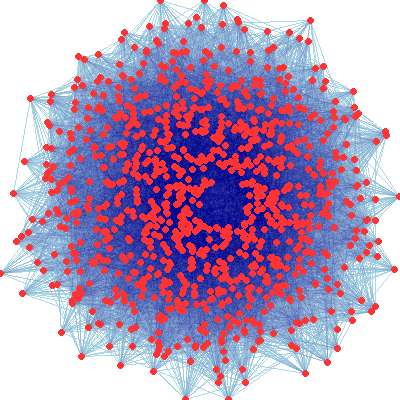
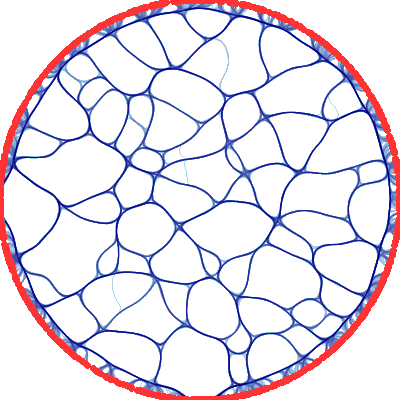
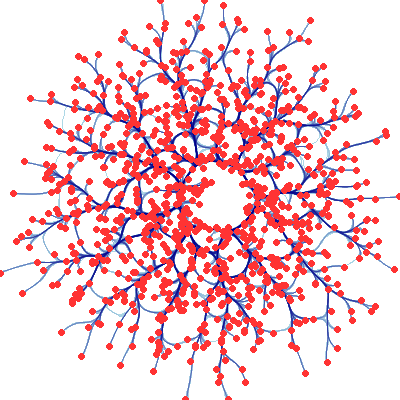

In [42]:
tf.Images(a, b, c, d).cols(2)

In [43]:
sample

,source,target,type,weight
112584,thehindupatrika,TheNileshDesai,mention,2967
44658,MetronixSA,TechCrunch,mention,1886
57176,Rodrick76496943,SportfusionApps,mention,1564
50748,Othershawnlong,xdadevelopers,mention,1182
35809,Jessica_L_Hunt,baltimoresun,mention,1012
...,...,...,...,...
115671,voltaverse,YouTube,mention,6
15129,ChimpReports,UgandanLawyer,mention,6
102355,outthereco,spencemckee,mention,6
104902,qcs_tr,JJMcCann,mention,6


In [44]:
sample_nodes = pd.DataFrame(pd.unique(sample[['source', 'target']].values.ravel('K')), columns = ['username'])
sample_edges = pd.DataFrame()

for idx, row in sample.iterrows():
    
    x = sample_nodes[sample_nodes['username'] == row['source']].index[0]
    y = sample_nodes[sample_nodes['username'] == row['target']].index[0]
    
    sample_edges = sample_edges.append({'source': x,
                                        'target': y,
                                        'weight': row['weight']}, ignore_index = True)

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  sample_edges = sample_edges.append({'source': x,
/tmp/ipykernel_4332/2495644382.py:9: FutureWarning: The frame.append method is deprecated and will be removed from p

In [45]:
sample_edges.head()

,source,target,weight
0,0,845,2967
1,1,846,1886
2,2,847,1564
3,3,848,1182
4,4,849,1012


In [46]:
sample_nodes[sample_nodes['username'] == row['source']].index[0]

29

In [47]:
circularloc  = circular_layout(sample_nodes, uniform = False)
forcedirectedloc = forceatlas2_layout(sample_nodes, sample_edges)

In [48]:
cd = circularloc
fd = forcedirectedloc

%time a = graphplot(cd, connect_edges(cd, sample_edges), "Circular layout")
%time b = graphplot(fd, connect_edges(fd, sample_edges), "Force Directed layout")
%time c = graphplot(cd, hammer_bundle(cd, sample_edges), "Circular layout, bundled")
%time d = graphplot(fd, hammer_bundle(fd, sample_edges), "Force-directed, bundled")

CPU times: user 17.4 ms, sys: 11.9 ms, total: 29.3 ms
Wall time: 27.9 ms
CPU times: user 19 ms, sys: 3.95 ms, total: 22.9 ms
Wall time: 22.8 ms
CPU times: user 3.05 s, sys: 0 ns, total: 3.05 s
Wall time: 3.04 s
CPU times: user 870 ms, sys: 36 µs, total: 870 ms
Wall time: 868 ms


Circular layout,Force Directed layout
"Circular layout, bundled","Force-directed, bundled"

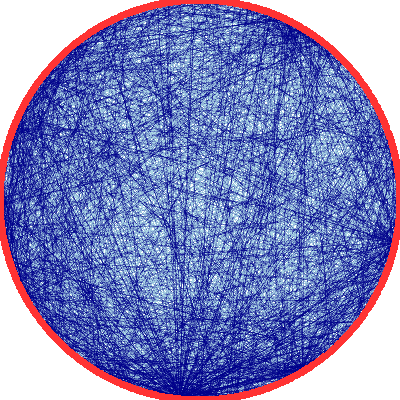
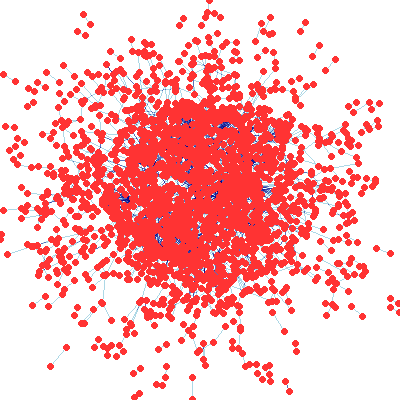
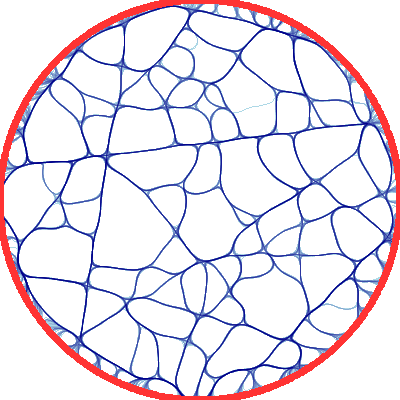
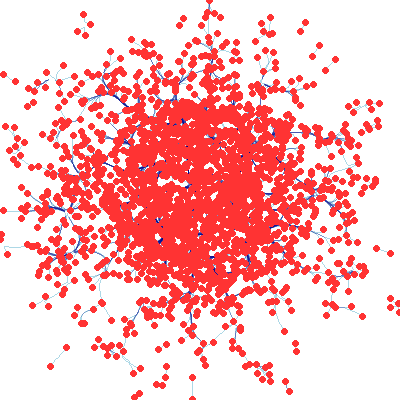

In [49]:
tf.Images(a, b, c, d).cols(2)

In [50]:
# Holoviews
kwargs = dict(width = 800, height = 800, xaxis = None, yaxis = None)
opts.defaults(opts.Nodes(**kwargs), opts.Graph(**kwargs))
colors = ['#000000'] + hv.Cycle('Category20').values

graph = hv.Graph(sample_edges)
bundled = bundle_graph(graph)
datashaded = (datashade(bundled, normalization = 'linear', width = 1000, height = 1000) * bundled.nodes).opts(opts.Nodes(color = 'circle', size = 10, width = 800, cmap = colors, legend_position = 'right'))

In [51]:
graph

:Graph   [source,target]   (weight)

In [52]:
bundled

:Graph   [source,target]   (weight)

In [53]:
datashaded

 Parameter(s) [normalization] not consumed by any element rasterizer.

 Parameter(s) [normalization] not consumed by any element rasterizer.



:DynamicMap   []
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Nodes.I :Nodes   [x,y,index]